In [ ]:
run_gridsearch = True
skip_best_model_validation = False
skip_best_model_test = False
verbose = False
GPU_SETTING = -1
NUM_ENSEMBLES = 5
RUNS_FILE = "guerneville_mts2_stored_runs.json"
hyperparam_csv_file = "guerneville_mts2_hyperparams_debug.csv"

In [ ]:
hyperparam_space = {
    "hidden_size": [64, 128, 256],
    "seq_length_1D": [90, 120],
    "seq_length_1H": [168, 336],
    "num_layers": [1],
    "epochs": [16, 32, 48],
    "batch_size": [64, 128],
    "schedule_pairs": [
        ((0.5, 0.25), (0.01, 0.005, 0.001))
    ]
}

In [2]:
import sys
import os
import itertools
import json
from pathlib import Path
from tqdm import tqdm
import warnings
from datetime import datetime
warnings.simplefilter(action='ignore', category=FutureWarning)

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all


In [ ]:
current_dir = os.getcwd()
print(current_dir)

In [3]:
library_path = os.path.join('..', '..', '..','..','UCB-USACE-LSTMs')
sys.path.insert(0, library_path)
print(sys.path)

['..\\..\\..\\..\\UCB-USACE-LSTMs', 'F:\\Dino\\UCB-USACE-LSTMs\\UCB_training\\models\\guerneville_all', 'C:\\Users\\Dino\\anaconda3\\python312.zip', 'C:\\Users\\Dino\\anaconda3\\DLLs', 'C:\\Users\\Dino\\anaconda3\\Lib', 'C:\\Users\\Dino\\anaconda3', '', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages\\win32', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages\\win32\\lib', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages\\Pythonwin']


In [ ]:
from neuralhydrology.evaluation.metrics import *
from UCB_training.UCB_train import UCB_trainer
from UCB_training.UCB_utils import (combinedPlot, fancyCombinedPlot, combinedPlotFromDf, fancyCombinedPlotFromDf, fractional_multi_lr, write_paths, to_path_or_list, extended_combined_plot, extended_combined_plot_from_df)

In [5]:
# Dynamically find the repo root from the current working directory
current_path = os.getcwd()
library_path = current_path.split('UCB-USACE-LSTMs')[0] + 'UCB-USACE-LSTMs'

# Construct the target path
target_path = os.path.join(library_path, 'UCB_training', 'models', 'guerneville_all')

# Verify if the directory exists before changing
if os.path.exists(target_path):
    os.chdir(target_path)
    print("Current Working Directory:", os.getcwd())
    print("Train Basin File Exists:", os.path.exists("guerneville")) 
else:
    print(f"Error: The target path '{target_path}' does not exist.")

Current Working Directory: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all
Train Basin File Exists: True


In [6]:
path_to_csv = Path(library_path +'/russian_river_data')
path_to_yaml = Path("guerneville_mtslstm2.yaml")
path_to_physics_data_1D = Path(library_path + "/russian_river_data/Guerneville_daily_averaged.csv")
path_to_physics_data_1H = Path(library_path + "/russian_river_data/Guerneville_hourly.csv")

In [7]:
features_with_physics = [
    "BIG SULPHUR CR ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "DRY CREEK 10 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "EF RUSSIAN 20 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "GREEN VALLEY ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "LAGUNA ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "RUSSIAN 20 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "RUSSIAN 30 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "RUSSIAN 40 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "RUSSIAN 50 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "RUSSIAN 60 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "RUSSIAN 70 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "SANTA ROSA CR 10 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "SANTA ROSA CR 20 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "WF RUSSIAN ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "BIG SULPHUR CR PRECIP-INC SCREENED",
    "DRY CREEK 10 PRECIP-INC SCREENED",
    "EF RUSSIAN 20 PRECIP-INC SCREENED",
    "GREEN VALLEY PRECIP-INC SCREENED",
    "LAGUNA PRECIP-INC SCREENED",
    "RUSSIAN 20 PRECIP-INC SCREENED",
    "RUSSIAN 30 PRECIP-INC SCREENED",
    "RUSSIAN 40 PRECIP-INC SCREENED",
    "RUSSIAN 50 PRECIP-INC SCREENED",
    "RUSSIAN 60 PRECIP-INC SCREENED",
    "RUSSIAN 70 PRECIP-INC SCREENED",
    "SANTA ROSA CR 10 PRECIP-INC SCREENED",
    "SANTA ROSA CR 20 PRECIP-INC SCREENED",
    "WF RUSSIAN PRECIP-INC SCREENED",
    "UKIAH CA HUMIDITY USAF-NOAA",
    "UKIAH CA SOLAR RADIATION USAF-NOAA",
    "UKIAH CA TEMPERATURE USAF-NOAA",
    "UKIAH CA WINDSPEED USAF-NOAA",
    "SANTA ROSA CA HUMIDITY USAF-NOAA",
    "SANTA ROSA CA SOLAR RADIATION USAF-NOAA",
    "SANTA ROSA CA TEMPERATURE USAF-NOAA",
    "SANTA ROSA CA WINDSPEED USAF-NOAA",
    "UKIAH CA FLOW USGS-MERGED",
    "GEYSERVILLE CA FLOW USGS-MERGED",
    "Guerneville Gage FLOW",
    "Big Sulphur Cr ET-POTENTIAL",
    "Big Sulphur Cr FLOW",
    "Big Sulphur Cr FLOW-BASE",
    "Big Sulphur Cr INFILTRATION",
    "Big Sulphur Cr PERC-SOIL",
    "Big Sulphur Cr SATURATION FRACTION",
    "Dry Creek 10 ET-POTENTIAL",
    "Dry Creek 10 FLOW",
    "Dry Creek 10 FLOW-BASE",
    "Dry Creek 10 INFILTRATION",
    "Dry Creek 10 PERC-SOIL",
    "Dry Creek 10 SATURATION FRACTION",
    "Green Valley ET-POTENTIAL",
    "Green Valley FLOW",
    "Green Valley FLOW-BASE",
    "Green Valley INFILTRATION",
    "Green Valley PERC-SOIL",
    "Green Valley SATURATION FRACTION",
    "Laguna ET-POTENTIAL",
    "Laguna FLOW",
    "Laguna FLOW-BASE",
    "Laguna INFILTRATION",
    "Laguna PERC-SOIL",
    "Laguna SATURATION FRACTION",
    "Russian 20 ET-POTENTIAL",
    "Russian 20 FLOW",
    "Russian 20 FLOW-BASE",
    "Russian 20 INFILTRATION",
    "Russian 20 PERC-SOIL",
    "Russian 20 SATURATION FRACTION",
    "Russian 30 ET-POTENTIAL",
    "Russian 30 FLOW",
    "Russian 30 FLOW-BASE",
    "Russian 30 INFILTRATION",
    "Russian 30 PERC-SOIL",
    "Russian 30 SATURATION FRACTION",
    "Russian 40 ET-POTENTIAL",
    "Russian 40 FLOW",
    "Russian 40 FLOW-BASE",
    "Russian 40 INFILTRATION",
    "Russian 40 PERC-SOIL",
    "Russian 40 SATURATION FRACTION",
    "Russian 50 ET-POTENTIAL",
    "Russian 50 FLOW",
    "Russian 50 FLOW-BASE",
    "Russian 50 INFILTRATION",
    "Russian 50 PERC-SOIL",
    "Russian 50 SATURATION FRACTION",
    "Russian 60 ET-POTENTIAL",
    "Russian 60 FLOW",
    "Russian 60 FLOW-BASE",
    "Russian 60 INFILTRATION",
    "Russian 60 PERC-SOIL",
    "Russian 60 SATURATION FRACTION",
    "Russian 70 ET-POTENTIAL",
    "Russian 70 FLOW",
    "Russian 70 FLOW-BASE",
    "Russian 70 INFILTRATION",
    "Russian 70 PERC-SOIL",
    "Russian 70 SATURATION FRACTION",
    "Santa Rosa Cr 10 ET-POTENTIAL",
    "Santa Rosa Cr 10 FLOW",
    "Santa Rosa Cr 10 FLOW-BASE",
    "Santa Rosa Cr 10 INFILTRATION",
    "Santa Rosa Cr 10 PERC-SOIL",
    "Santa Rosa Cr 10 SATURATION FRACTION",
    "Santa Rosa Cr 20 ET-POTENTIAL",
    "Santa Rosa Cr 20 FLOW",
    "Santa Rosa Cr 20 FLOW-BASE",
    "Santa Rosa Cr 20 INFILTRATION",
    "Santa Rosa Cr 20 PERC-SOIL",
    "Santa Rosa Cr 20 SATURATION FRACTION",
    "WF Russian ET-POTENTIAL",
    "WF Russian FLOW",
    "WF Russian FLOW-BASE",
    "WF Russian INFILTRATION",
    "WF Russian PERC-SOIL",
    "WF Russian SATURATION FRACTION"
]

In [ ]:
no_physics_results = []
physics_results = []

In [9]:
start_time = datetime.utcnow()
print("Start time:", start_time.strftime("%Y-%m-%d %H:%M:%S"))

Start time: 2025-05-15 18:59:27


C:\Users\Dino\AppData\Local\Temp\ipykernel_41208\2387850673.py:3: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  start_time = datetime.utcnow()


In [ ]:
hyperparam_names = []
for i, hp in enumerate(hyperparam_space.keys()):
    hyperparam_names.append(hp)

total_iters = 1
for name in hyperparam_names:
    total_iters *= len(hyperparam_space[name])

if run_gridsearch or not os.path.exists(hyperparam_csv_file):
    for combinations in tqdm(
        itertools.product(*[hyperparam_space[hp] for hp in hyperparam_names]), 
        desc="Grid-Search", 
        total=total_iters, 
        unit="it", 
        ncols=60, 
        ascii=True):

        hp_run = {}
        j = 0
        while j < len(hyperparam_names):
            if hyperparam_names[j] != "seq_length_1D" or hyperparam_names[j] != "seq_length_1H":
                hp_run[hyperparam_names[j]] = combinations[j]
                j += 1
            else:
                hp_run["seq_length"] = {"1D": combinations[j], "1H": combinations[j + 1]}
                j += 2

        if verbose:
            print(f"\nNoPhysics: {hp_run}")
        trainer = UCB_trainer(
            path_to_csv_folder=path_to_csv,
            yaml_path=path_to_yaml,
            hyperparams=hp_run,
            input_features=None,
            physics_informed=False,
            physics_data_file=None,
            hourly=True,  
            extend_train_period=False,
            gpu=GPU_SETTING,
            is_mts = True,
            verbose=verbose,
        )
        trainer.train()
        csv_1d, metrics_1d = trainer.results(period="validation", mts_trk="1D")
        csv_1h, metrics_1h = trainer.results(period="validation", mts_trk="1H")
        
        row_data = {}
        j = 0
        while j < len(hyperparam_names):
            if hyperparam_names[j] == "learning_rate":
                row_data[hyperparam_names[j]] = str(combinations[j])
            else:
                row_data[hyperparam_names[j]] = combinations[j]
            j += 1
        for k, v in metrics_1d.items():
            row_data[k] = v
        for k, v in metrics_1h.items():
            row_data[k] = v
        
        no_physics_results.append(row_data)

    df_no_physics = pd.DataFrame(no_physics_results)
    df_no_physics.sort_values(by="NSE", ascending=False, inplace=True)
    df_no_physics.reset_index(drop=True, inplace=True)
else:
    print("Skipping grid search!")

In [ ]:
if run_gridsearch or not os.path.exists(hyperparam_csv_file):    
    for combinations in tqdm(
        itertools.product(*[hyperparam_space[hp] for hp in hyperparam_names]), 
        desc="Grid-Search", 
        total=total_iters, 
        unit="it", ncols=60, 
        ascii=True):

        if "schedule_pairs" in hyperparam_names:
            (f1, f2), (lr1, lr2, lr3) = combinations[hyperparam_names.index("schedule_pairs")]

            fractions = [f1, f2]
            lr_list = [lr1, lr2, lr3]


            lr_dict = fractional_multi_lr(
                epochs=combinations[hyperparam_names.index("epochs")],
                fractions=fractions,
                lrs=lr_list,
                round_up=True)


        hp_run = {}
        j = 0
        while j < len(hyperparam_names):
            if hyperparam_names[j] != "seq_length_1D" or hyperparam_names[j] != "seq_length_1H":
                hp_run[hyperparam_names[j]] = combinations[j]
                j += 1
            else:
                hp_run["seq_length"] = {"1D": combinations[j], "1H": combinations[j + 1]}
                j += 2
        if verbose:
            print(f"\nPhysics: {hp_run}")
        trainer = UCB_trainer(
            path_to_csv_folder=path_to_csv,
            yaml_path=path_to_yaml,
            hyperparams=hp_run,
            input_features=features_with_physics,
            physics_informed=True,
            physics_data_file=path_to_physics_data_1H,
            hourly=True,
            extend_train_period=False,
            gpu=GPU_SETTING,
            is_mts = True,
            verbose=verbose,
        )
        trainer.train()
        csv_path, metrics_dict = trainer.results()

        row_data = {}
        j = 0
        while j < len(hyperparam_names):
            if hyperparam_names[j] == "learning_rate":
                row_data[hyperparam_names[j]] = str(combinations[j])
            else:
                row_data[hyperparam_names[j]] = combinations[j]
            j += 1

        for k, v in metrics_dict.items():
            row_data[k] = v
        physics_results.append(row_data)
    df_physics = pd.DataFrame(physics_results)
    df_physics.sort_values(by="NSE", ascending=False, inplace=True)
    df_physics.reset_index(drop=True, inplace=True)
    best_no_phys = df_no_physics.iloc[0].to_dict()
    best_phys = df_physics.iloc[0].to_dict()
    best_no_phys["model_type"] = "no_physics"
    best_phys["model_type"] = "physics"
    best_params_df = pd.DataFrame([best_no_phys, best_phys])
    best_params_df.to_csv(hyperparam_csv_file, index=False)
else:
    print("Skipping grid search!")

In [12]:
if run_gridsearch:
    print(df_no_physics.iloc[0:4])
    df_no_physics.to_csv("guerneville_mts2_no_physics_gridsearch.csv", index=False)

In [13]:
if run_gridsearch:
    print(df_physics.iloc[0:4])
    df_physics.to_csv("guerneville_mts2_physics_gridsearch.csv", index=False)

In [ ]:
if os.path.exists(hyperparam_csv_file):
    best_params_df = pd.read_csv(hyperparam_csv_file)
    best_no_phys = best_params_df.query("model_type == 'no_physics'").iloc[0].to_dict()
    best_phys = best_params_df.query("model_type == 'physics'").iloc[0].to_dict()


    best_no_physics_params = {}
    j = 0
    while j < len(hyperparam_names):
        if hyperparam_names[j] == "output_dropout":
            best_no_physics_params[hyperparam_names[j]] = float(best_no_phys[hyperparam_names[j]])
            j += 1
        elif hyperparam_names[j] == "learning_rate":
            best_no_physics_params[hyperparam_names[j]] = eval(str(best_no_phys[hyperparam_names[j]]))
            j += 1
        elif hyperparam_names[j] == "seq_length_1D" or hyperparam_names[j] == "seq_length_1H":
            best_no_physics_params["seq_length"] = {"1D": int(best_no_phys[hyperparam_names[j]]), "1H": int(best_no_phys[hyperparam_names[j + 1]])}
            j += 2
        elif hyperparam_names[j] == "schedule_pairs":
            j += 1
            continue
        else:
            best_no_physics_params[hyperparam_names[j]] = int(best_no_phys[hyperparam_names[j]])
            j += 1
    
    best_physics_params = {}
    j = 0
    while j < len(hyperparam_names):
        if hyperparam_names[j] == "output_dropout":
            best_physics_params[hyperparam_names[j]] = float(best_phys[hyperparam_names[j]])
            j += 1
        elif hyperparam_names[j] == "learning_rate":
            best_physics_params[hyperparam_names[j]] = eval(str(best_phys[hyperparam_names[j]]))
            j += 1
        elif hyperparam_names[j] == "seq_length_1D" or hyperparam_names[j] == "seq_length_1H":
            best_physics_params["seq_length"] = {"1D": int(best_phys[hyperparam_names[j]]), "1H": int(best_phys[hyperparam_names[j + 1]])}
            j += 2
        elif hyperparam_names[j] == "schedule_pairs":
            j += 1
            continue
        else:
            best_physics_params[hyperparam_names[j]] = int(best_phys[hyperparam_names[j]])
            j += 1

    print("Loaded best hyperparams from CSV:")
    print("Best NO-PHYS:", best_no_physics_params)
    print("Best PHYS:", best_physics_params)
else:
    print(f"Error: {hyperparam_csv_file} not found. Did you run gridsearch?")

In [ ]:
if not skip_best_model_validation:
    noPhysValTrainer = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_no_physics_params,
        input_features=None,
        physics_informed=False,
        physics_data_file=None,
        hourly=True,
        extend_train_period=False,
        gpu=GPU_SETTING,
        is_mts = True,
        # num_ensemble_members = NUM_ENSEMBLES,
        verbose=verbose
    )
    noPhysValTrainer.train()
    noPhys_val_csv_1D, noPhys_val_metrics_1D = noPhysValTrainer.results(period="validation", mts_trk="1D")
    noPhys_val_csv_1H, noPhys_val_metrics_1H = noPhysValTrainer.results(period="validation", mts_trk="1H")
    print("NO-PHYS VAL 1D => NSE =", noPhys_val_metrics_1D.get("NSE", None))
    print("NO-PHYS VAL 1H => NSE =", noPhys_val_metrics_1H.get("NSE", None))

In [ ]:
if not skip_best_model_validation:
    physValTrainer = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_physics_params,
        input_features=features_with_physics,
        physics_informed=True,
        physics_data_file=path_to_physics_data_1H,
        hourly=True,
        extend_train_period=False,
        gpu=GPU_SETTING,
        is_mts = True,
        # num_ensemble_members = NUM_ENSEMBLES,
        verbose=verbose
    )
    physValTrainer.train()
    phys_val_csv_1D, phys_val_metrics_1D = physValTrainer.results(period="validation", mts_trk="1D")
    phys_val_csv_1H, phys_val_metrics_1H = physValTrainer.results(period="validation", mts_trk="1H")
    print("PHYS VAL 1D => NSE =", phys_val_metrics_1D.get("NSE", None))
    print("PHYS VAL 1H => NSE =", phys_val_metrics_1H.get("NSE", None))

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed

[INFO] Wrote metrics CSV: guerneville_mts2_val_metrics_1D.csv


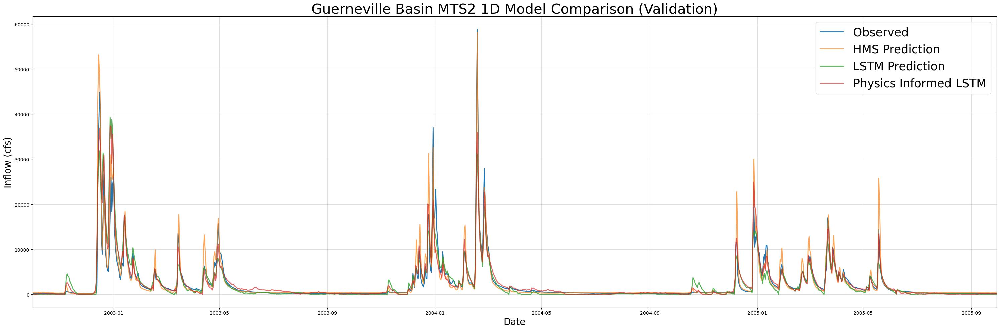

In [ ]:
if not skip_best_model_validation:
    print("\nPlotting combined MTS results (Validation, 1D)...")
    combinedPlot(
        lstm_results=noPhys_val_csv_1D,
        lstmPhysics_results=phys_val_csv_1D,
        HMS_results=path_to_physics_data_1D,
        title="Guerneville Basin MTS2 1D Model Comparison (Validation)",
        fName="guerneville_mts2_val_metrics_1D.csv",
        plot_filename="guerneville_mts2_val_1D_comparison.png",
        timeseries_filename="guerneville_mts2_val_1D_combined_ts.csv"
    )
else:
    combined_df_1D = pd.read_csv("guerneville_mts2_val_1D_combined_ts.csv")
    combinedPlotFromDf(
        combined_df_1D,
        title="Guerneville Basin MTS2 1D Model Comparison (Validation)",
        fName="guerneville_mts2_val_metrics_1D.csv"
    )

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed

[INFO] Wrote metrics CSV: guerneville_mts2_val_metrics_1D.csv


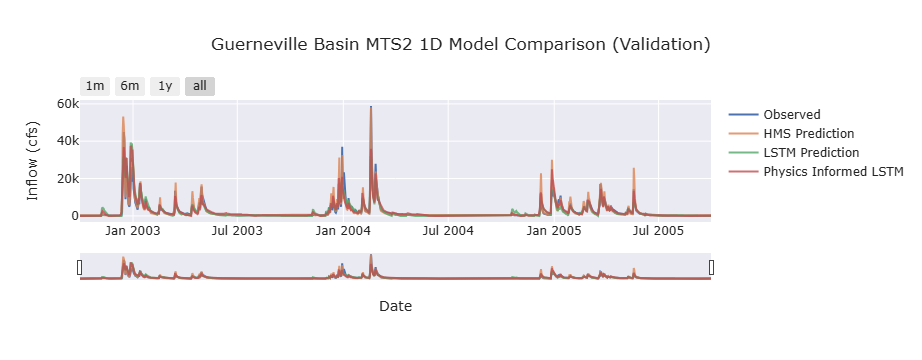

In [ ]:
if not skip_best_model_validation:
    fancyCombinedPlot(
        lstm_results=noPhys_val_csv_1D,
        lstmPhysics_results=phys_val_csv_1D,
        HMS_results=path_to_physics_data_1D,
        title="Guerneville Basin MTS2 1D Model Comparison (Validation)",
        fName="guerneville_mts2_val_metrics_1D.csv",
        timeseries_filename="guerneville_mts2_val_1D_combined_ts.csv"
    )
else:
    fancyCombinedPlotFromDf(
        combined_df_1D,
        title="Guerneville Basin MTS2 1D Model Comparison (Validation)",
        fName="guerneville_mts2_val_metrics_1D.csv"
    )

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UC

[INFO] Wrote metrics CSV: guerneville_mts2_val_metrics_1H.csv


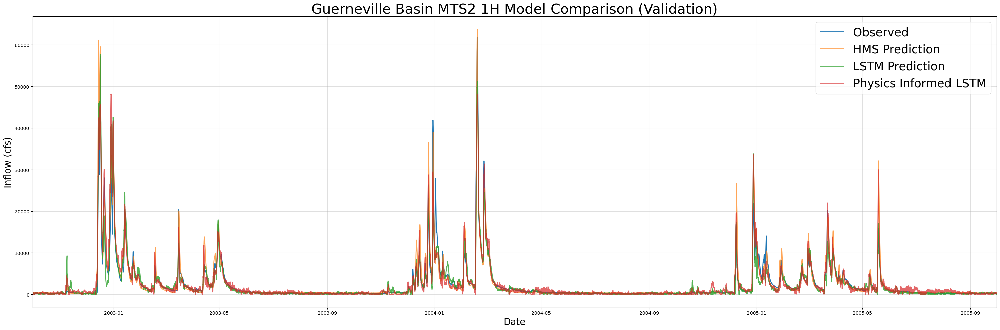

In [ ]:
if not skip_best_model_validation:
    print("\nPlotting combined MTS results (Validation, 1H)...")
    combinedPlot(
        lstm_results=noPhys_val_csv_1H,
        lstmPhysics_results=phys_val_csv_1H,
        HMS_results=path_to_physics_data_1H,
        title="Guerneville Basin MTS2 1H Model Comparison (Validation)",
        fName="guerneville_mts2_val_metrics_1H.csv",
        plot_filename="guerneville_mts2_val_1H_comparison.png",
        timeseries_filename="guerneville_mts2_val_1H_combined_ts.csv"
    )
else:
    combined_df_1H = pd.read_csv("guerneville_mts2_val_1H_combined_ts.csv")
    combinedPlotFromDf(
        combined_df_1H,
        title="Guerneville Basin MTS2 1H Model Comparison (Validation)",
        fName="guerneville_mts2_val_metrics_1H.csv"
    )

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UC

[INFO] Wrote metrics CSV: guerneville_mts2_val_metrics_1H.csv


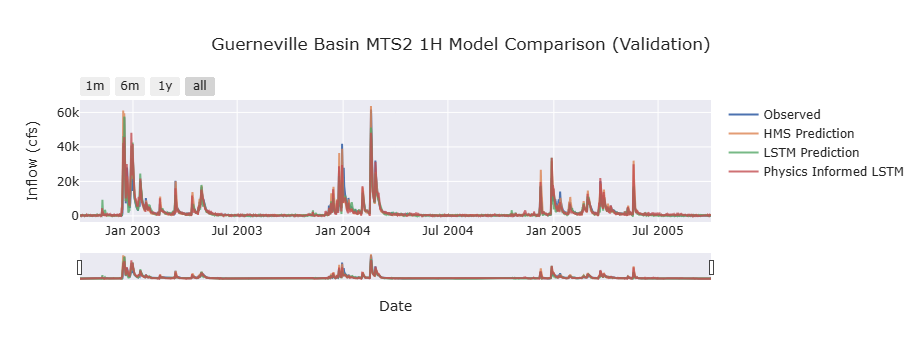

In [ ]:
if not skip_best_model_validation:
    fancyCombinedPlot(
        lstm_results=noPhys_val_csv_1H,
        lstmPhysics_results=phys_val_csv_1H,
        HMS_results=path_to_physics_data_1H,
        title="Guerneville Basin MTS2 1H Model Comparison (Validation)",
        fName="guerneville_mts2_val_metrics_1H.csv",
        timeseries_filename="guerneville_mts2_val_1H_combined_ts.csv"
    )
else:
    fancyCombinedPlotFromDf(
        combined_df_1H,
        title="Guerneville Basin MTS2 1H Model Comparison (Validation)",
        fName="guerneville_mts2_val_metrics_1H.csv"
    )

In [ ]:
if skip_best_model_validation:
    val_metrics = pd.read_csv("guerneville_mts2_val_metrics_1D.csv")
    print(val_metrics)

     Unnamed: 0           HMS          LSTM  Physics_Informed_LSTM
0           NSE  8.838126e-01  7.936087e-01           8.581178e-01
1           MSE  2.877408e+06  5.111329e+06           3.513745e+06
2          RMSE  1.696292e+03  2.260825e+03           1.874499e+03
3           KGE  8.771921e-01  8.800593e-01           9.174299e-01
4     Alpha-NSE  1.099769e+00  9.557783e-01           9.751580e-01
5      Beta-KGE  1.053141e+00  9.680776e-01           1.031162e+00
6      Beta-NSE  2.564405e-02 -1.540454e-02           1.503779e-02
7     Pearson-r  9.520009e-01  8.931769e-01           9.276841e-01
8           FHV  1.155736e+01 -2.472055e+00           5.416268e-01
9           FMS -1.807299e+01  6.020483e+01           4.792618e+00
10          FLV  7.415392e+00 -5.407604e+02          -1.724961e+03
11  Peak-Timing  2.000000e-01  4.000000e-01           0.000000e+00
12    Peak-MAPE  3.011588e+01  4.115324e+01           2.435292e+01
13        PBIAS -5.314139e+00  3.192237e+00          -3.116235

In [ ]:
if skip_best_model_validation:
    val_metrics = pd.read_csv("guerneville_mts2_val_metrics_1H.csv")
    print(val_metrics)

     Unnamed: 0           HMS          LSTM  Physics_Informed_LSTM
0           NSE  8.687420e-01  8.745160e-01           8.828601e-01
1           MSE  3.413030e+06  3.262892e+06           3.045926e+06
2          RMSE  1.847439e+03  1.806348e+03           1.745258e+03
3           KGE  8.777309e-01  9.253087e-01           9.085002e-01
4     Alpha-NSE  1.095071e+00  9.853039e-01           1.051787e+00
5      Beta-KGE  1.053188e+00  9.633794e-01           1.052548e+00
6      Beta-NSE  2.504759e-02 -1.724545e-02           2.474623e-02
7     Pearson-r  9.444821e-01  9.365827e-01           9.458799e-01
8           FHV  7.928709e+00  1.084257e+00           7.597413e+00
9           FMS -1.844487e+01  2.886156e-01          -1.100736e+01
10          FLV  1.566814e+01 -2.472000e+03          -1.836044e+03
11  Peak-Timing           NaN           NaN                    NaN
12    Peak-MAPE  2.347954e+01  2.716229e+01           2.282765e+01
13        PBIAS -5.318843e+00  3.662062e+00          -5.254850

# Test Period

In [ ]:
if not skip_best_model_test:
    print("\nTraining No-Physics MTS2 model for test period...")
    mtsNoPhysicsTest = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_no_physics_params,
        input_features=None,
        physics_informed=False,
        physics_data_file=None,
        hourly=True,
        extend_train_period=True,
        gpu=GPU_SETTING,
        num_ensemble_members = NUM_ENSEMBLES,
        is_mts = True,
        verbose=verbose
    )
    mtsNoPhysicsTest.train()
    no_physics_test_csv_1D, no_physics_test_metrics_1D = mtsNoPhysicsTest.results(period="test", mts_trk="1D")
    no_physics_test_csv_1H, no_physics_test_metrics_1H = mtsNoPhysicsTest.results(period="test", mts_trk="1H")
    print("\n[No-Physics Test] NSE @1D =", no_physics_test_metrics_1D.get("NSE", None))
    print("[No-Physics Test] NSE @1H =", no_physics_test_metrics_1H.get("NSE", None))

In [ ]:
if not skip_best_model_test:
    print("\nTraining Physics MTS model for test period...")
    mtsPhysicsTest = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_physics_params,
        input_features=features_with_physics,
        physics_informed=True,
        physics_data_file=path_to_physics_data_1H,
        hourly=True,
        extend_train_period=True,
        gpu=GPU_SETTING,
        num_ensemble_members = NUM_ENSEMBLES,
        is_mts = True,
        verbose=verbose
    )
    mtsPhysicsTest.train()
    physics_test_csv_1D, physics_test_metrics_1D = mtsPhysicsTest.results(period="test", mts_trk="1D")
    physics_test_csv_1H, physics_test_metrics_1H = mtsPhysicsTest.results(period="test", mts_trk="1H")
    print("\n[Physics Test] NSE @1D =", physics_test_metrics_1D.get("NSE", None))
    print("[Physics Test] NSE @1H =", physics_test_metrics_1H.get("NSE", None))

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UC

[INFO] Wrote metrics CSV: guerneville_mts2_test_metrics_1D.csv


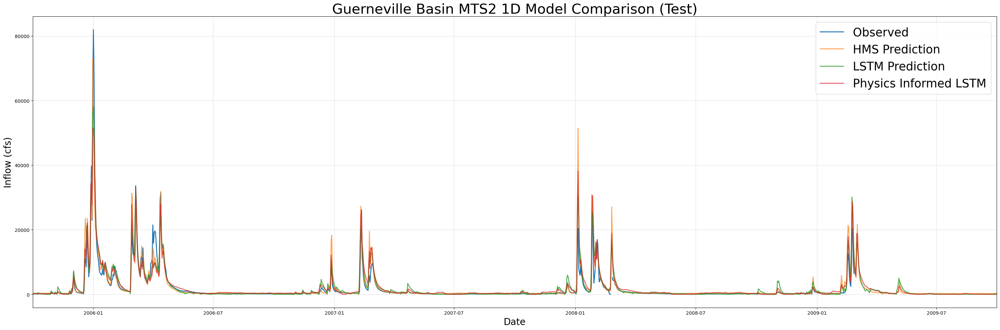

In [ ]:
if not skip_best_model_test:
    print("\nPlotting combined MTS2 results (Test, 1D)...")
    combinedPlot(
        lstm_results=no_physics_test_csv_1D,
        lstmPhysics_results=physics_test_csv_1D,
        HMS_results=path_to_physics_data_1D,
        title="Guerneville Basin MTS2 1D Model Comparison (Test)",
        fName="guerneville_mts2_test_metrics_1D.csv",
        plot_filename="guerneville_mts2_test_1D_comparison.png",
        timeseries_filename="guerneville_mts2_test_1D_combined_ts.csv"
    )
else:
    combined_df_test_1D = pd.read_csv("guerneville_mts2_test_1D_combined_ts.csv")
    combinedPlotFromDf(
        combined_df_test_1D,
        title="Guerneville Basin MTS2 1D Model Comparison (Test)",
        fName="guerneville_mts2_test_metrics_1D.csv"
    )

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UC

[INFO] Wrote metrics CSV: guerneville_mts2_test_metrics_1D.csv


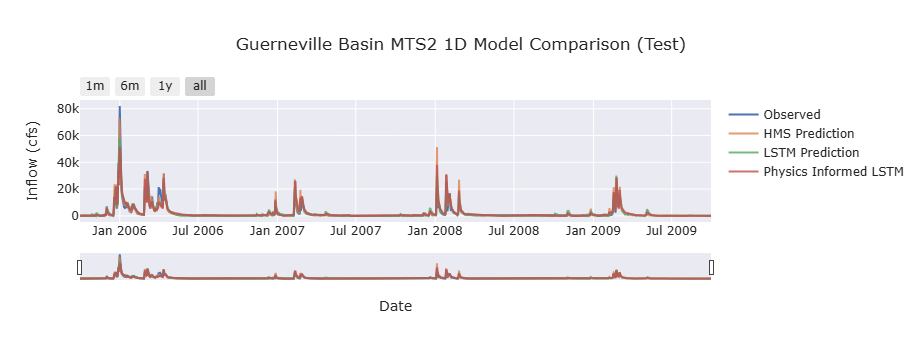

In [ ]:
if not skip_best_model_test:
    fancyCombinedPlot(
        lstm_results=no_physics_test_csv_1D,
        lstmPhysics_results=physics_test_csv_1D,
        HMS_results=path_to_physics_data_1D,
        title="Guerneville Basin MTS2 1D Model Comparison (Test)",
        fName="guerneville_mts2_test_metrics_1D.csv",
        timeseries_filename="guerneville_mts2_test_1D_combined_ts.csv"
    )
else:
    fancyCombinedPlotFromDf(
        combined_df_test_1D,
        title="Guerneville Basin MTS2 1D Model Comparison (Test)",
        fName="guerneville_mts2_test_metrics_1D.csv"
    )

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UC

[INFO] Wrote metrics CSV: guerneville_mts2_test_metrics_1H.csv


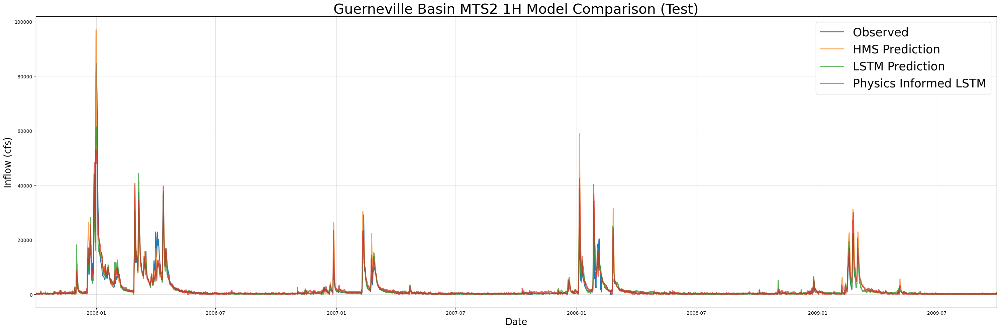

In [ ]:
if not skip_best_model_test:
    print("\nPlotting combined MTS2 results (Test, 1H)...")
    combinedPlot(
        lstm_results=no_physics_test_csv_1H,
        lstmPhysics_results=physics_test_csv_1H,
        HMS_results=path_to_physics_data_1H,
        title="Guerneville Basin MTS2 1H Model Comparison (Test)",
        fName="guerneville_mts2_test_metrics_1H.csv",
        plot_filename="guerneville_mts2_test_1H_comparison.png",
        timeseries_filename="guerneville_mts2_test_1H_combined_ts.csv"
    )
else:
    combined_df_test_1H = pd.read_csv("guerneville_mts2_test_1H_combined_ts.csv")
    combinedPlotFromDf(
        combined_df_test_1H,
        title="Guerneville Basin MTS2 1H Model Comparison (Test)",
        fName="guerneville_mts2_test_metrics_1H.csv"
    )

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\guerneville_all\..\..\..\..\UC

[INFO] Wrote metrics CSV: guerneville_mts2_test_metrics_1H.csv


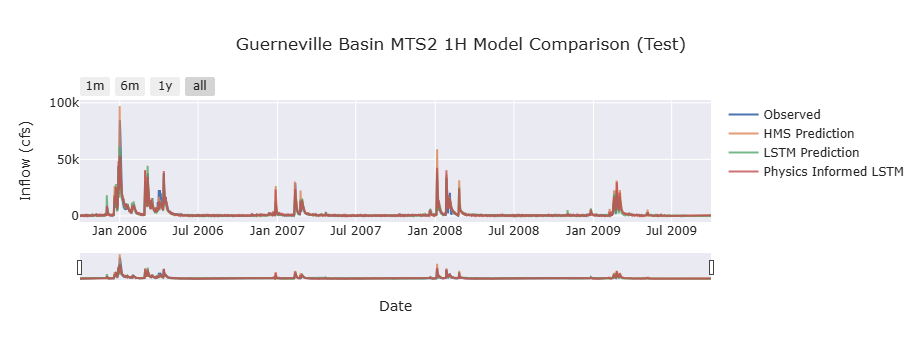

In [ ]:
if not skip_best_model_test:
    fancyCombinedPlot(
        lstm_results=no_physics_test_csv_1H,
        lstmPhysics_results=physics_test_csv_1H,
        HMS_results=path_to_physics_data_1H,
        title="Guerneville Basin MTS2 1H Model Comparison (Test)",
        fName="guerneville_mts2_test_metrics_1H.csv",
        timeseries_filename="guerneville_mts2_test_1H_combined_ts.csv"
    )
else:
    fancyCombinedPlotFromDf(
        combined_df_test_1H,
        title="Guerneville Basin MTS2 1H Model Comparison (Test)",
        fName="guerneville_mts2_test_metrics_1H.csv"
    )

In [ ]:
test_metrics = pd.read_csv("guerneville_mts2_test_metrics_1D.csv", index_col=0)
print(test_metrics, index_col=0)

     Unnamed: 0           HMS          LSTM  Physics_Informed_LSTM
0           NSE  8.496090e-01  8.752491e-01           8.756787e-01
1           MSE  4.626364e+06  3.837618e+06           3.824403e+06
2          RMSE  2.150898e+03  1.958984e+03           1.955608e+03
3           KGE  8.413793e-01  8.240722e-01           8.070672e-01
4     Alpha-NSE  1.027734e+00  9.714982e-01           9.532166e-01
5      Beta-KGE  1.138778e+00  1.162109e+00           1.176591e+00
6      Beta-NSE  4.871714e-02  5.690711e-02           6.199107e-02
7     Pearson-r  9.283625e-01  9.378794e-01           9.379523e-01
8           FHV  2.298750e+00 -3.911805e+00           2.216046e-01
9           FMS -2.472629e+01  4.410067e+01          -5.388365e+00
10          FLV  9.758592e+01  4.902240e+01           2.238137e+01
11  Peak-Timing  8.000000e-01  6.000000e-01           2.000000e-01
12    Peak-MAPE  1.410643e+01  2.951809e+01           2.226850e+01
13        PBIAS -1.387784e+01 -1.621088e+01          -1.765912

In [65]:
test_metrics = pd.read_csv("guerneville_mts2_test_metrics_1H.csv", index_col=0)
print(test_metrics)

     Unnamed: 0           HMS          LSTM  Physics_Informed_LSTM
0           NSE  8.397567e-01  8.986476e-01           8.730396e-01
1           MSE  5.100840e+06  3.226233e+06           4.041384e+06
2          RMSE  2.258504e+03  1.796172e+03           2.010319e+03
3           KGE  8.420785e-01  8.505858e-01           8.304524e-01
4     Alpha-NSE  1.031696e+00  8.812303e-01           9.441042e-01
5      Beta-KGE  1.134681e+00  1.076200e+00           1.146616e+00
6      Beta-NSE  4.641451e-02  2.626053e-02           5.052776e-02
7     Pearson-r  9.238708e-01  9.508888e-01           9.357682e-01
8           FHV  2.602950e+00 -1.196871e+01          -1.232408e+00
9           FMS -2.485552e+01 -8.722690e+00          -4.353342e+00
10          FLV  9.756574e+01  7.414933e+00           2.044527e+01
11  Peak-Timing           NaN           NaN                    NaN
12    Peak-MAPE  2.625178e+01  2.506556e+01           2.280406e+01
13        PBIAS -1.346808e+01 -7.620010e+00          -1.466163

In [32]:
end_time = datetime.utcnow()
print("End time:", end_time.strftime("%Y-%m-%d %H:%M:%S"))
print("total time:", end_time - start_time)

End time: 2025-05-15 18:59:47
total time: 0:00:19.993704


C:\Users\Dino\AppData\Local\Temp\ipykernel_41208\1304433041.py:2: DeprecationWarning:

datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).



In [ ]:
if not skip_best_model_test:
    write_paths("no_physics", mtsNoPhysicsTest, filename = RUNS_FILE)
    write_paths("physics", mtsPhysicsTest, filename = RUNS_FILE)
saved = json.loads(Path(RUNS_FILE).read_text())

##### Reload Models For Prediction

In [ ]:
runner_np = UCB_trainer.from_run_dir(to_path_or_list(saved["no_physics"]), gpu=GPU_SETTING, verbose=verbose)
runner_p = UCB_trainer.from_run_dir(to_path_or_list(saved["physics"]), gpu=GPU_SETTING, verbose=verbose)

In [ ]:
pred_np_d_train_validation, obs_np_d_train_validation, met_np_d_train_validation = runner_np.predict(period="train_validation", mts_trk="1D")
met_np_d_train_validation.to_dict()

In [ ]:
pred_np_d_test, obs_np_d_test, met_np_d_test = runner_np.predict(period="test", mts_trk="1D")
met_np_d_test.to_dict()

In [ ]:
pred_np_h_train_validation, obs_np_h_train_validation, met_np_h_train_validation = runner_np.predict(period="train_validation", mts_trk="1H")
met_np_h_train_validation.to_dict()

In [ ]:
pred_np_h_test, obs_np_h_test, met_np_h_test = runner_np.predict(period="test", mts_trk="1H")
met_np_h_test.to_dict()

In [ ]:
pred_p_d_train_validation, obs_p_d_train_validation, met_p_d_train_validation = runner_p.predict(period="train_validation", mts_trk="1D")
met_p_d_train_validation.to_dict()

In [ ]:
pred_p_d_test, obs_p_d_test, met_p_d_test = runner_p.predict(period="test", mts_trk="1D")
met_p_d_test.to_dict()

In [ ]:
pred_p_h_train_validation, obs_p_h_train_validation, met_p_h_train_validation = runner_p.predict(period="train_validation", mts_trk="1H")
met_p_h_train_validation.to_dict()

In [ ]:
pred_p_h_test, obs_p_h_test, met_p_h_test = runner_p.predict(period="test", mts_trk="1H")
met_p_h_test.to_dict()

##### Additional plots

In [ ]:
wettest_start = "2005-10-01"
wettest_end = "2006-09-30"
dryest_start = "2008-10-01"
dryest_end = "2009-09-30"
metric_list = ["NSE", "PBIAS"]

##### Wettest Year Performance

In [ ]:
if not skip_best_model_test:
    extended_combined_plot(
        lstm_results=no_physics_test_csv_1D,
        lstmPhysics_results=physics_test_csv_1D,
        HMS_results=path_to_physics_data_1D,
        title="Guerneville Daily MTS Wettest Year Timeseries",
        start_date=wettest_start,
        end_date=wettest_end,
        metrics=metric_list,
        fName="guerneville_mts2_wet_metrics_1D.csv",
        timeseries_filename="guerneville_mts2_wet_ts_1D.csv",
        plot_filename="guerneville_mts2_wet_plot_1D.png")
else:
    extended_combined_plot_from_df(
        df=combined_df_test_1D,
        title="Guerneville Daily MTS Wettest Year Timeseries",
        start_date=wettest_start,
        end_date=wettest_end,
        metrics=metric_list,
        fName="guerneville_mts2_wet_metrics_1D.csv",
        timeseries_filename="guerneville_mts2_wet_ts_1D.csv",
        plot_filename="guerneville_mts2_wet_plot_1D.png")

In [ ]:
if not skip_best_model_test:
    extended_combined_plot(
        lstm_results=no_physics_test_csv_1D,
        lstmPhysics_results=physics_test_csv_1D,
        HMS_results=path_to_physics_data_1D,
        title="Guerneville Daily MTS Wettest Year Timeseries - Interactive",
        start_date=wettest_start,
        end_date=wettest_end,
        metrics=metric_list,
        fName="guerneville_mts2_wet_metrics_1D.csv",
        timeseries_filename="guerneville_mts2_wet_ts_1D.csv",
        plot_filename="guerneville_mts2_wet_plot_1D.png",
        interactive=True)
else:
    extended_combined_plot_from_df(
        df=combined_df_test_1D,
        title="Guerneville Daily MTS Wettest Year Timeseries - Interactive",
        start_date=wettest_start,
        end_date=wettest_end,
        metrics=metric_list,
        fName="guerneville_mts2_wet_metrics_1D.csv",
        timeseries_filename="guerneville_mts2_wet_ts_1D.csv",
        plot_filename="guerneville_mts2_wet_plot_1D.png",
        interactive=True)

In [ ]:
if not skip_best_model_test:
    extended_combined_plot(
        lstm_results=no_physics_test_csv_1H,
        lstmPhysics_results=physics_test_csv_1H,
        HMS_results=path_to_physics_data_1H,
        title="Guerneville Hourly MTS Wettest Year Timeseries",
        start_date=wettest_start,
        end_date=wettest_end,
        metrics=metric_list,
        fName="guerneville_mts2_wet_metrics_1H.csv",
        timeseries_filename="guerneville_mts2_wet_ts_1H.csv",
        plot_filename="guerneville_mts2_wet_plot_1H.png")
else:
    extended_combined_plot_from_df(
        df=combined_df_test_1H,
        title="Guerneville Hourly MTS Wettest Year Timeseries",
        start_date=wettest_start,
        end_date=wettest_end,
        metrics=metric_list,
        fName="guerneville_mts2_wet_metrics_1H.csv",
        timeseries_filename="guerneville_mts2_wet_ts_1H.csv",
        plot_filename="guerneville_mts2_wet_plot_1H.png")

In [ ]:
if not skip_best_model_test:
    extended_combined_plot(
        lstm_results=no_physics_test_csv_1H,
        lstmPhysics_results=physics_test_csv_1H,
        HMS_results=path_to_physics_data_1H,
        title="Guerneville Hourly MTS Wettest Year Timeseries - Interactive",
        start_date=wettest_start,
        end_date=wettest_end,
        metrics=metric_list,
        fName="guerneville_mts2_wet_metrics_1H.csv",
        timeseries_filename="guerneville_mts2_wet_ts_1H.csv",
        plot_filename="guerneville_mts2_wet_plot_1H.png",
        interactive=True)
else:
    extended_combined_plot_from_df(
        df=combined_df_test_1H,
        title="Guerneville Hourly MTS Wettest Year Timeseries - Interactive",
        start_date=wettest_start,
        end_date=wettest_end,
        metrics=metric_list,
        fName="guerneville_mts2_wet_metrics_1H.csv",
        timeseries_filename="guerneville_mts2_wet_ts_1H.csv",
        plot_filename="guerneville_mts2_wet_plot_1H.png",
        interactive=True)

##### Dryest Year Performance

In [ ]:
if not skip_best_model_test:
    extended_combined_plot(
        lstm_results=no_physics_test_csv_1D,
        lstmPhysics_results=physics_test_csv_1D,
        HMS_results=path_to_physics_data_1D,
        title="Guerneville Daily MTS Dryest Year Timeseries",
        start_date=dryest_start,
        end_date=dryest_end,
        metrics=metric_list,
        fName="guerneville_mts2_dry_metrics_1D.csv",
        timeseries_filename="guerneville_mts2_dry_ts_1D.csv",
        plot_filename="guerneville_mts2_dry_plot_1D.png")
else:
    extended_combined_plot_from_df(
        df=combined_df_test_1D,
        title="Guerneville Daily MTS Dryest Year Timeseries",
        start_date=dryest_start,
        end_date=dryest_end,
        metrics=metric_list,
        fName="guerneville_mts2_dry_metrics_1D.csv",
        timeseries_filename="guerneville_mts2_dry_ts_1D.csv",
        plot_filename="guerneville_mts2_dry_plot_1D.png")

In [ ]:
if not skip_best_model_test:
    extended_combined_plot(
        lstm_results=no_physics_test_csv_1D,
        lstmPhysics_results=physics_test_csv_1D,
        HMS_results=path_to_physics_data_1D,
        title="Guerneville Daily MTS Dryest Year Timeseries - Interactive",
        start_date=dryest_start,
        end_date=dryest_end,
        metrics=metric_list,
        fName="guerneville_mts2_dry_metrics_1D.csv",
        timeseries_filename="guerneville_mts2_dry_ts_1D.csv",
        plot_filename="guerneville_mts2_dry_plot_1D.png",
        interactive=True)
else:
    extended_combined_plot_from_df(
        df=combined_df_test_1D,
        title="Guerneville Daily MTS Dryest Year Timeseries - Interactive",
        start_date=dryest_start,
        end_date=dryest_end,
        metrics=metric_list,
        fName="guerneville_mts2_dry_metrics_1D.csv",
        timeseries_filename="guerneville_mts2_dry_ts_1D.csv",
        plot_filename="guerneville_mts2_dry_plot_1D.png",
        interactive=True)

In [ ]:
if not skip_best_model_test:
    extended_combined_plot(
        lstm_results=no_physics_test_csv_1H,
        lstmPhysics_results=physics_test_csv_1H,
        HMS_results=path_to_physics_data_1H,
        title="Guerneville Hourly MTS Dryest Year Timeseries",
        start_date=dryest_start,
        end_date=dryest_end,
        metrics=metric_list,
        fName="guerneville_mts2_dry_metrics_1H.csv",
        timeseries_filename="guerneville_mts2_dry_ts_1H.csv",
        plot_filename="guerneville_mts2_dry_plot_1H.png")
else:
    extended_combined_plot_from_df(
        df=combined_df_test_1H,
        title="Guerneville Hourly MTS Dryest Year Timeseries",
        start_date=dryest_start,
        end_date=dryest_end,
        metrics=metric_list,
        fName="guerneville_mts2_dry_metrics_1H.csv",
        timeseries_filename="guerneville_mts2_dry_ts_1H.csv",
        plot_filename="guerneville_mts2_dry_plot_1H.png")

In [ ]:
if not skip_best_model_test:
    extended_combined_plot(
        lstm_results=no_physics_test_csv_1H,
        lstmPhysics_results=physics_test_csv_1H,
        HMS_results=path_to_physics_data_1H,
        title="Guerneville Hourly MTS Dryest Year Timeseries - Interactive",
        start_date=dryest_start,
        end_date=dryest_end,
        metrics=metric_list,
        fName="guerneville_mts2_dry_metrics_1H.csv",
        timeseries_filename="guerneville_mts2_dry_ts_1H.csv",
        plot_filename="guerneville_mts2_dry_plot_1H.png",
        interactive=True)
else:
    extended_combined_plot_from_df(
        df=combined_df_test_1H,
        title="Guerneville Hourly MTS Dryest Year Timeseries - Interactive",
        start_date=dryest_start,
        end_date=dryest_end,
        metrics=metric_list,
        fName="guerneville_mts2_dry_metrics_1H.csv",
        timeseries_filename="guerneville_mts2_dry_ts_1H.csv",
        plot_filename="guerneville_mts2_dry_plot_1H.png",
        interactive=True)